<a href="https://www.kaggle.com/code/sunilkumaradapa/unleashing-h2o-automl-on-kaggle?scriptVersionId=165694122" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# Steel Plate Defect Prediction

# ****#  **** 🚀 If you found this notebook helpful or insightful, I'd be over the moon if you could spare a moment to give it an upvote! Your support means the world to me and encourages me to keep creating content like this. Thank you in advance! 🙏 🤝


 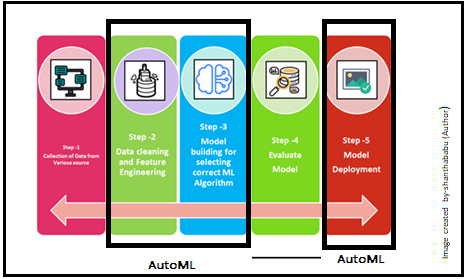

**Automated machine learning (AutoML):**
is the process of automating the end-to-end process of applying machine learning to real-world problems. In a typical machine learning application, the typical stages (and sub-stages) of work are the following:

Data preparation
data pre-processing
feature engineering
feature extraction
feature selection
Model selection
Hyperparameter optimization (to maximize the performance of the final model)
Many of these steps are often beyond the abilities of non-experts. AutoML was proposed as an artificial intelligence-based solution to the ever-growing challenge of applying machine learning.

**Some of the notable platforms tackling various stages of AutoML are the following:**

* **auto-sklearn** is a Bayesian hyperparameter optimization layer on top of scikit-learn.
* **TPOT (TeaPOT)** is a Python library that automatically creates and optimizes full machine learning pipelines using genetic programming.
* **TransmogrifAI** is a Scala/SparkML library created by Salesforce for automated data cleansing, feature engineering, model selection, and hyperparameter optimization.
***H2O AutoML** performs (simple) data preprocessing, automates the process of training a large selection of candidate models, tunes hyperparameters of the models and creates stacked ensembles.
* **H2O Driverless AI** is a commercial software package that automates lots of aspects of machine learning applications. It has a strong focus on automatic feature engineering.


# Import Libraries

In [1]:
#Import Libararies
import numpy as np, pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport
import h2o
import shap
from h2o.automl import H2OAutoML
from sklearn.model_selection import train_test_split

# Load the Data

In [2]:
train_data = pd.read_csv(r"/kaggle/input/playground-series-s4e3/train.csv")
test_data = pd.read_csv(r"/kaggle/input/playground-series-s4e3/test.csv")
#original data
orig_data = pd.read_csv("/kaggle/input/steel-plate-defects-predictions-original-csv/PlaygroundS4E3Original.csv")

In [3]:
""""# Combine fault columns into a single column
orig_data['Fault_Type'] = orig_data[['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']].idxmax(axis=1)

# Replace 'no fault' for rows with all zeros in fault columns
no_fault_mask = (orig_data[['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']] == 0).all(axis=1)
orig_data.loc[no_fault_mask, 'Fault_Type'] = 'No_Fault'

# Drop individual fault columns if not needed anymore
orig_data.drop(columns=['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults'], inplace=True)
orig_data.to_csv("Train_Original_Data.csv",index=False)
# Display the modified DataFrame
#print(train_data)"""


'"# Combine fault columns into a single column\norig_data[\'Fault_Type\'] = orig_data[[\'Pastry\', \'Z_Scratch\', \'K_Scatch\', \'Stains\', \'Dirtiness\', \'Bumps\', \'Other_Faults\']].idxmax(axis=1)\n\n# Replace \'no fault\' for rows with all zeros in fault columns\nno_fault_mask = (orig_data[[\'Pastry\', \'Z_Scratch\', \'K_Scatch\', \'Stains\', \'Dirtiness\', \'Bumps\', \'Other_Faults\']] == 0).all(axis=1)\norig_data.loc[no_fault_mask, \'Fault_Type\'] = \'No_Fault\'\n\n# Drop individual fault columns if not needed anymore\norig_data.drop(columns=[\'Pastry\', \'Z_Scratch\', \'K_Scatch\', \'Stains\', \'Dirtiness\', \'Bumps\', \'Other_Faults\'], inplace=True)\norig_data.to_csv("Train_Original_Data.csv",index=False)\n# Display the modified DataFrame\n#print(train_data)'

In [4]:
#original_data 
o_data = pd.read_csv(r'/kaggle/input/steel-plate-data-original/Train_Original_Data.csv')
o_data

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Fault_Type
0,1,42,50,270900,270944,267,17,44,24220,76,...,0.4706,1.0000,1.0,2.4265,0.9031,1.6435,0.8182,-0.2913,0.5822,Pastry
1,2,645,651,2538079,2538108,108,10,30,11397,84,...,0.6000,0.9667,1.0,2.0334,0.7782,1.4624,0.7931,-0.1756,0.2984,Pastry
2,3,829,835,1553913,1553931,71,8,19,7972,99,...,0.7500,0.9474,1.0,1.8513,0.7782,1.2553,0.6667,-0.1228,0.2150,Pastry
3,4,853,860,369370,369415,176,13,45,18996,99,...,0.5385,1.0000,1.0,2.2455,0.8451,1.6532,0.8444,-0.1568,0.5212,Pastry
4,5,1289,1306,498078,498335,2409,60,260,246930,37,...,0.2833,0.9885,1.0,3.3818,1.2305,2.4099,0.9338,-0.1992,1.0000,Pastry
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1936,1937,249,277,325780,325796,273,54,22,35033,119,...,0.5185,0.7273,0.0,2.4362,1.4472,1.2041,-0.4286,0.0026,0.7254,Other_Faults
1937,1938,144,175,340581,340598,287,44,24,34599,112,...,0.7046,0.7083,0.0,2.4579,1.4914,1.2305,-0.4516,-0.0582,0.8173,Other_Faults
1938,1939,145,174,386779,386794,292,40,22,37572,120,...,0.7250,0.6818,0.0,2.4654,1.4624,1.1761,-0.4828,0.0052,0.7079,Other_Faults
1939,1940,137,170,422497,422528,419,97,47,52715,117,...,0.3402,0.6596,0.0,2.6222,1.5185,1.4914,-0.0606,-0.0171,0.9919,Other_Faults


In [5]:
#Load the data 
df_data1 = pd.read_csv(r"/kaggle/input/steel-plate-defect-prediction-dataset/Train_Data.csv")
df_data1

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Fault_Type
0,0,584,590,909972,909977,16,8,5,2274,113,...,1.0000,1.0000,0.0,1.2041,0.9031,0.6990,-0.5000,-0.0104,0.1417,Stains
1,1,808,816,728350,728372,433,20,54,44478,70,...,0.2500,1.0000,1.0,2.6365,0.7782,1.7324,0.7419,-0.2997,0.9491,Other_Faults
2,2,39,192,2212076,2212144,11388,705,420,1311391,29,...,0.2363,0.3857,0.0,4.0564,2.1790,2.2095,-0.0105,-0.0944,1.0000,K_Scatch
3,3,781,789,3353146,3353173,210,16,29,3202,114,...,0.3750,0.9310,1.0,2.3222,0.7782,1.4314,0.6667,-0.0402,0.4025,K_Scatch
4,4,1540,1560,618457,618502,521,72,67,48231,82,...,0.2105,0.9861,1.0,2.7694,1.4150,1.8808,0.9158,-0.2455,0.9998,Other_Faults
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19214,19214,749,757,143210,143219,17,4,4,2193,122,...,1.0000,0.8000,0.0,1.2305,0.7782,0.6021,-0.1429,0.0044,0.2901,Stains
19215,19215,723,735,2488529,2488541,231,17,26,27135,104,...,0.7333,0.9216,1.0,2.3636,1.0414,1.4150,0.7222,-0.0989,0.5378,Other_Faults
19216,19216,6,31,1578055,1578129,780,114,98,71112,41,...,0.1862,0.9554,1.0,2.8921,1.4314,1.8692,0.7719,-0.4283,0.9997,Pastry
19217,19217,9,18,1713172,1713184,126,13,26,14808,88,...,0.7692,1.0000,1.0,2.1004,1.0414,1.4150,0.9610,-0.1162,0.3509,Other_Faults


In [6]:
#lets concat the Two Data Frames 
df_data = pd.concat([df_data1, o_data], axis=0)
df_data

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Fault_Type
0,0,584,590,909972,909977,16,8,5,2274,113,...,1.0000,1.0000,0.0,1.2041,0.9031,0.6990,-0.5000,-0.0104,0.1417,Stains
1,1,808,816,728350,728372,433,20,54,44478,70,...,0.2500,1.0000,1.0,2.6365,0.7782,1.7324,0.7419,-0.2997,0.9491,Other_Faults
2,2,39,192,2212076,2212144,11388,705,420,1311391,29,...,0.2363,0.3857,0.0,4.0564,2.1790,2.2095,-0.0105,-0.0944,1.0000,K_Scatch
3,3,781,789,3353146,3353173,210,16,29,3202,114,...,0.3750,0.9310,1.0,2.3222,0.7782,1.4314,0.6667,-0.0402,0.4025,K_Scatch
4,4,1540,1560,618457,618502,521,72,67,48231,82,...,0.2105,0.9861,1.0,2.7694,1.4150,1.8808,0.9158,-0.2455,0.9998,Other_Faults
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1936,1937,249,277,325780,325796,273,54,22,35033,119,...,0.5185,0.7273,0.0,2.4362,1.4472,1.2041,-0.4286,0.0026,0.7254,Other_Faults
1937,1938,144,175,340581,340598,287,44,24,34599,112,...,0.7046,0.7083,0.0,2.4579,1.4914,1.2305,-0.4516,-0.0582,0.8173,Other_Faults
1938,1939,145,174,386779,386794,292,40,22,37572,120,...,0.7250,0.6818,0.0,2.4654,1.4624,1.1761,-0.4828,0.0052,0.7079,Other_Faults
1939,1940,137,170,422497,422528,419,97,47,52715,117,...,0.3402,0.6596,0.0,2.6222,1.5185,1.4914,-0.0606,-0.0171,0.9919,Other_Faults


# Explore the Data

*** id**: An identifier for each entry.
* **X_Minimum, X_Maximum, Y_Minimum, Y_Maximum**: These columns seem to represent the minimum and maximum coordinates of some bounding box or area.
* **Pixels_Areas**: The area of pixels in the given bounding box or area.
* **X_Perimeter, Y_Perimeter**: The perimeter along the x and y axes respectively.
* **Sum_of_Luminosity, Minimum_of_Luminosity**: These seem to be related to luminosity values.
* **Orientation_Index, Luminosity_Index, SigmoidOfAreas**: These appear to be numerical indices or values related to orientation, luminosity, and the sigmoid function applied to areas. 
* **Pastry, Z_Scratch, K_Scratch, Stains, Dirtiness, Bumps, Other_Faults**: These columns likely represent counts or indicators of different types of faults present in the data.

In [7]:
df_data.shape #train_data

(21160, 29)

In [8]:
#shape of train data 
test_data.shape

(12814, 28)

In [9]:
#test data
test_data

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas
0,19219,1015,1033,3826564,3826588,659,23,46,62357,67,...,0.0095,0.5652,1.0000,1.0,2.8410,1.1139,1.6628,0.6727,-0.2261,0.9172
1,19220,1257,1271,419960,419973,370,26,28,39293,92,...,0.0047,0.2414,1.0000,1.0,2.5682,0.9031,1.4472,0.9063,-0.1453,0.9104
2,19221,1358,1372,117715,117724,289,36,32,29386,101,...,0.0155,0.6000,0.7500,0.0,2.4609,1.3222,1.3222,-0.5238,-0.0435,0.6514
3,19222,158,168,232415,232440,80,10,11,8586,107,...,0.0037,0.8000,1.0000,1.0,1.9031,0.6990,1.0414,0.1818,-0.0738,0.2051
4,19223,559,592,544375,544389,140,19,15,15524,103,...,0.0158,0.8421,0.5333,0.0,2.1461,1.3222,1.1461,-0.5714,-0.0894,0.4170
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12809,32028,1101,1116,447943,447992,313,32,37,21603,79,...,0.0126,0.4063,0.9194,1.0,2.4955,1.2305,1.6335,0.7661,-0.3109,0.8894
12810,32029,1289,1306,3149494,3149542,59,9,18,5249,113,...,0.0052,0.7778,1.0000,1.0,1.7708,0.8451,1.2553,0.7222,-0.0448,0.1954
12811,32030,41,210,1587535,1587191,16584,796,522,1858162,24,...,0.1236,0.2199,0.4097,0.0,4.2525,2.2504,2.2672,-0.0629,-0.0801,1.0000
12812,32031,1329,1340,702237,702267,386,43,34,36875,66,...,0.0095,0.2407,1.0000,1.0,2.5866,1.1139,1.5911,0.8461,-0.2629,0.7844


In [10]:
#check the null values 
df_data.isnull().sum()#there is no null values 
#check test data for null values 
test_data.isnull().sum()

id                       0
X_Minimum                0
X_Maximum                0
Y_Minimum                0
Y_Maximum                0
Pixels_Areas             0
X_Perimeter              0
Y_Perimeter              0
Sum_of_Luminosity        0
Minimum_of_Luminosity    0
Maximum_of_Luminosity    0
Length_of_Conveyer       0
TypeOfSteel_A300         0
TypeOfSteel_A400         0
Steel_Plate_Thickness    0
Edges_Index              0
Empty_Index              0
Square_Index             0
Outside_X_Index          0
Edges_X_Index            0
Edges_Y_Index            0
Outside_Global_Index     0
LogOfAreas               0
Log_X_Index              0
Log_Y_Index              0
Orientation_Index        0
Luminosity_Index         0
SigmoidOfAreas           0
dtype: int64

In [11]:
#check for duplicated values 
df_data.duplicated().sum()
test_data.duplicated().sum()

0

# AutoEDA
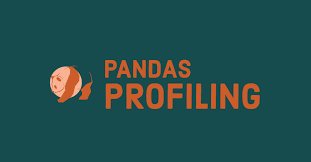
# Pandas Profiling:
* is an awesome python package for exploratory analysis (EDA). It extends pandas for statistical analysis summaries including correlations, missing values, distribution (quantile), and descriptive statistics

# Auto EDA

In [12]:
#Auto EDA
Auto_eda =ProfileReport(df_data,title="Auto EDA Report")

In [13]:
Auto_eda

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

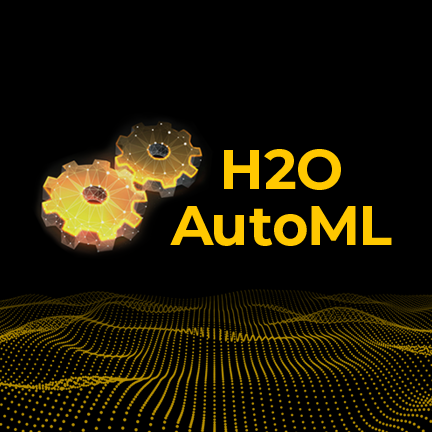

Links : [H2O Doc ](https://docs.h2o.ai/h2o/latest-stable/h2o-docs/automl.html)

In [14]:
#start H2o
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.21" 2023-10-17; OpenJDK Runtime Environment (build 11.0.21+9-post-Ubuntu-0ubuntu120.04); OpenJDK 64-Bit Server VM (build 11.0.21+9-post-Ubuntu-0ubuntu120.04, mixed mode, sharing)
  Starting server from /opt/conda/lib/python3.10/site-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpr1kbxn4r
  JVM stdout: /tmp/tmpr1kbxn4r/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpr1kbxn4r/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.44.0.3
H2O_cluster_version_age:,2 months and 14 days
H2O_cluster_name:,H2O_from_python_unknownUser_xzwlg2
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,7.500 Gb
H2O_cluster_total_cores:,4
H2O_cluster_allowed_cores:,4
H2O_cluster_status:,"locked, healthy"


# Load the data into H2O Frame

In [15]:
#Remove the unnecessary columns:
df_drop_train= df_data.drop(['id'],axis=1)
df_drop_test = test_data.drop(['id'],axis=1)


In [16]:
#load the data into H20 frame:
h2o_train = h2o.H2OFrame(df_drop_train)
h2o_test = h2o.H2OFrame(df_drop_test)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [17]:
h2o_train.describe(chunk_summary=True)

Rows:21160
Cols:28

Chunk compression summary: 
chunk_type    chunk_name                 count    count_percentage    size      size_percentage
------------  -------------------------  -------  ------------------  --------  -----------------
CBS           Binary                     2        7.14286             5.3 KB    0.375444
C1N           1-Byte Integers (w/o NAs)  3        10.7143             62.2 KB   4.40328
C1S           1-Byte Fractions           1        3.57143             20.7 KB   1.46887
C2            2-Byte Integers            6        21.4286             248.4 KB  17.5849
C2S           2-Byte Fractions           6        21.4286             248.5 KB  17.5915
C4            4-Byte Integers            4        14.2857             330.9 KB  23.4277
C4S           4-Byte Fractions           6        21.4286             496.4 KB  35.1482

Frame distribution summary: 
                 size    number_of_rows    number_of_chunks_per_column    number_of_chunks
---------------  ------  ----------------  -----------------------------  ------------------
127.0.0.1:54321  1.4 MB  21160             1                              28
mean             1.4 MB  21160             1                              28
min              1.4 MB  21160             1                              28
max              1.4 MB  21160             1                              28
stddev           0  B    0                 0                              0
total            1.4 MB  21160             1                              28

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Fault_Type
type,int,int,int,int,int,int,int,int,int,int,int,int,int,int,real,real,real,real,real,real,real,real,real,real,real,real,real,enum
mins,0.0,4.0,6712.0,6724.0,2.0,2.0,1.0,250.0,0.0,37.0,1227.0,0.0,0.0,40.0,0.0,0.0,0.0083,0.0015,0.0144,0.0484,0.0,0.301,0.301,0.0,-0.991,-0.9989,0.119,
mean,697.1300567107724,741.3922022684302,1831495.3053875195,1828638.5614839257,1703.240831758038,97.14073724007552,65.85245746691892,193173.59111531262,84.78459357277879,128.78922495274128,1459.3332703213582,0.40245746691871453,0.5966446124763705,76.44470699432908,0.35099247637050934,0.40975839177693874,0.5741761086956578,0.03086177221172025,0.6143623015122848,0.8299844664461241,0.5904158790170166,2.4752095604914794,1.3147783270321372,1.3909781521739089,0.10095777032136044,-0.137732639413988,0.573142216209828,
maxs,1705.0,1713.0,12987661.0,12987692.0,152655.0,10449.0,18152.0,11591414.0,203.0,253.0,1794.0,1.0,1.0,300.0,0.9952,0.9439,1.0,0.8759,1.0,1.0,1.0,5.1837,3.0741,4.2587,0.9917,0.6421,1.0,
sigma,532.0545736890411,501.16009036942444,1892921.7462747907,1886265.9634040843,3884.8008509241276,192.51000771712162,161.18756595327375,448934.78632055834,29.121342051108147,14.672935939027552,145.474687555587,0.49040475107231163,0.4905825035141245,54.04244109179243,0.31731003526846624,0.12540844081608168,0.26051924808330573,0.04849323389422107,0.22438527255614862,0.22227610424106006,0.48208886760969755,0.7632203688927542,0.4691624682067341,0.4102740941595914,0.48892520230875586,0.12323745265637359,0.3329033913744134,
zeros,364,0,0,0,0,0,0,0,6,0,0,12644,8535,0,485,4,0,0,0,0,8268,0,0,5,826,2,0,
missing,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,584.0,590.0,909972.0,909977.0,16.0,8.0,5.0,2274.0,113.0,140.0,1358.0,0.0,1.0,50.0,0.7393,0.4,0.5,0.0059,1.0,1.0,0.0,1.2041,0.9031,0.699,-0.5,-0.0104,0.1417,Stains
1,808.0,816.0,728350.0,728372.0,433.0,20.0,54.0,44478.0,70.0,111.0,1687.0,1.0,0.0,80.0,0.7772,0.2878,0.2581,0.0044,0.25,1.0,1.0,2.6365,0.7782,1.7324,0.7419,-0.2997,0.9491,Other_Faults
2,39.0,192.0,2212076.0,2212144.0,11388.0,705.0,420.0,1311391.0,29.0,141.0,1400.0,0.0,1.0,40.0,0.0557,0.5282,0.9895,0.1077,0.2363,0.3857,0.0,4.0564,2.179,2.2095,-0.0105,-0.0944,1.0,K_Scatch


# Split Train and Test

In [18]:
#Here response & predictor column by saving them x and y
response= "Fault_Type" #response
features= h2o_train.columns
features.remove(response)


# Run AutoML (H2O)

 [Parameters H2o](https://docs.h2o.ai/h2o/latest-stable/h2o-docs/parameters.html) ..check in Documentations for more parameters

# Here are some key parameters commonly used in H2O AutoML:

*** max_runtime_secs**: Specifies the maximum time in seconds that the AutoML process should run.
* **max_models**: Sets the maximum number of models to be trained by AutoML.
* **stopping_metric**: Determines the metric used to select the best models. Common options include 'AUC', 'logloss', 'RMSE', 'mae', etc. 
* **stopping_rounds**: Defines the number of consecutive AutoML iterations without improvement on the stopping_metric before the process stops. 
* **seed**: Sets the random seed for reproducibility. 
* **nfolds**: Specifies the number of cross-validation folds to use during model training. 
* **include_algos**: A list of algorithms to include in the AutoML process. If provided, only the specified algorithms will be considered.
* **exclude_algos**: A list of algorithms to exclude from the AutoML process.
* **sort_metric**: Determines the metric used to rank models. It can be different from the stopping_metric and is often used for sorting the leaderboard. 
* **balance_classes**: Specifies whether to balance class distribution in the training dataset.

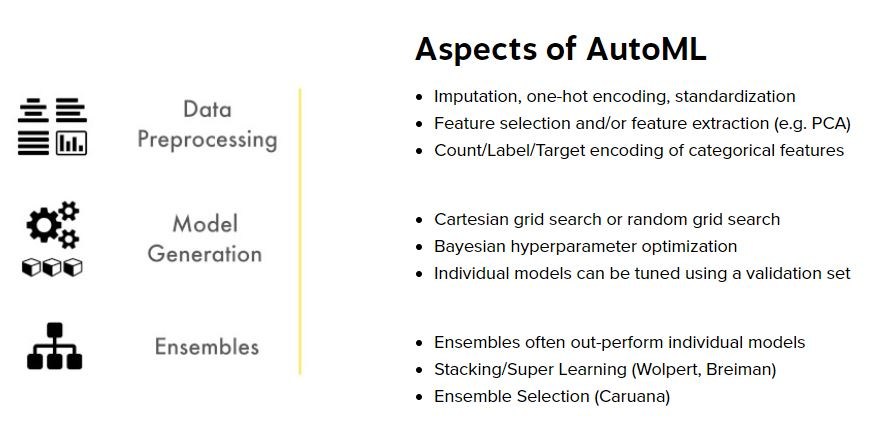

In [19]:
AML = H2OAutoML(nfolds=5,distribution="multinomial",keep_cross_validation_models=True,keep_cross_validation_predictions=True,balance_classes=True,max_models=None,max_runtime_secs=1800,seed=1234)
AML.train(x=features,y=response,training_frame=h2o_train)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),8/8
# GBM base models (used / total),4/4
# XGBoost base models (used / total),2/2
# GLM base models (used / total),1/1
# DRF base models (used / total),1/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None


# LeaderBoard

In [20]:
#lets see the leaderboard
LB=AML.leaderboard
LB.head()

model_id,mean_per_class_error,logloss,rmse,mse
StackedEnsemble_AllModels_1_AutoML_1_20240306_104111,0.482894,0.995973,0.584198,0.341288
StackedEnsemble_BestOfFamily_1_AutoML_1_20240306_104111,0.484494,1.00072,0.585282,0.342555
XGBoost_3_AutoML_1_20240306_104111,0.48867,1.01324,0.590824,0.349072
StackedEnsemble_BestOfFamily_2_AutoML_1_20240306_104111,0.489027,1.00046,0.586088,0.3435
StackedEnsemble_BestOfFamily_3_AutoML_1_20240306_104111,0.491382,1.00815,0.586617,0.344119
XGBoost_1_AutoML_1_20240306_104111,0.498752,1.07685,0.590226,0.348367
GBM_2_AutoML_1_20240306_104111,0.505019,1.03796,0.582545,0.339359
XGBoost_2_AutoML_1_20240306_104111,0.505072,1.0708,0.587152,0.344747
StackedEnsemble_AllModels_2_AutoML_1_20240306_104111,0.508903,1.02382,0.590759,0.348996
GBM_1_AutoML_1_20240306_104111,0.512968,1.04903,0.580192,0.336623


In [21]:
#save the top model 
top_model =AML.leader

# Save the Model

In [22]:
#save the model
save_model =h2o.save_model(top_model,path="/kaggle/working/",force=True)

# Submission

In [23]:
loaded_model = h2o.load_model(path=save_model)#loaded the leader model
predictions=loaded_model.predict(h2o_test)#predictions on test data
predictions_df = predictions.as_data_frame()
test_data_with_ids = pd.read_csv("/kaggle/input/playground-series-s4e3/test.csv")
test_id = test_data_with_ids['id']
sub = predictions_df.drop(['predict','No_Fault'],axis=1)
output_file = pd.DataFrame({"id": test_id,
                             "Pastry": sub['Pastry'],
                             "Z_Scratch": sub['Z_Scratch'],
                             "K_Scatch": sub['K_Scatch'],
                             "Stains": sub['Stains'],
                             "Dirtiness": sub['Dirtiness'],
                             "Bumps": sub['Bumps'],
                             "Other_Faults": sub['Other_Faults'],
                             })
output_file.to_csv("submit_file.csv", index=False)# csv file

stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
Export File progress: |██████████████████████████████████████████████████████████| (done) 100%


In [24]:
output_file

,id,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,19219,0.459022,0.001808,0.001976,0.000406,0.019998,0.145466,0.341108
1,19220,0.258415,0.007654,0.007317,0.001038,0.186754,0.169462,0.326759
2,19221,0.004877,0.049543,0.059272,0.001224,0.005898,0.283859,0.521826
3,19222,0.056267,0.002327,0.000376,0.001005,0.007738,0.497633,0.400325
4,19223,0.003545,0.003278,0.000365,0.000664,0.004398,0.614156,0.341226
...,...,...,...,...,...,...,...,...
12809,32028,0.144150,0.044849,0.000789,0.001130,0.044132,0.271353,0.440203
12810,32029,0.173847,0.009945,0.023278,0.002530,0.137871,0.200332,0.407128
12811,32030,0.000071,0.000070,0.936091,0.000012,0.000086,0.000263,0.052686
12812,32031,0.412183,0.006264,0.029566,0.000876,0.096541,0.084535,0.336227
